In [ ]:

# import fitz  # PyMuPDF
# import os

# def pdf_to_txt(pdf_path, txt_path):
#     doc = fitz.open(pdf_path)
#     text = ""
#     for page in doc:
#         text += page.get_text()
#     with open(txt_path, "w", encoding="utf-8") as f:
#         f.write(text)

# def batch_convert(pdf_dir, txt_dir):
#     os.makedirs(txt_dir, exist_ok=True)

#     for root, _, files in os.walk(pdf_dir):
#         for file in files:
#             if file.endswith(".pdf"):

#                 # 判断是否为深度报告
#                 is_deep = "深度报告" in root

#                 pdf_path = os.path.join(root, file)

#                 # ✅ 构造新的目标目录，而不是修改 txt_dir 本身
#                 if is_deep:
#                     target_dir = os.path.join(txt_dir, "深度报告")
#                 else:
#                     target_dir = txt_dir

#                 os.makedirs(target_dir, exist_ok=True)

#                 # ✅ txt_path 也基于 target_dir，而不是 txt_dir
#                 txt_path = os.path.join(target_dir, file.replace(".pdf", ".txt"))

#                 print(f"正在转换: {pdf_path}")
#                 pdf_to_txt(pdf_path, txt_path)


In [ ]:
import fitz  # PyMuPDF
import os

def pdf_to_txt(pdf_path, txt_path):
    doc = fitz.open(pdf_path)
    text = ""
    for page in doc:
        text += page.get_text()
    with open(txt_path, "w", encoding="utf-8") as f:
        f.write(text)


def batch_convert(pdf_dir, txt_dir):
    for root, _, files in os.walk(pdf_dir):
        for file in files:
            if not file.endswith(".pdf"):
                continue

            pdf_path = os.path.join(root, file)

            # -----------------------------
            # 1. 判断是否为深度报告
            # -----------------------------
            is_deep = "深度报告" in root

            # -----------------------------
            # 2. 提取股票名称（父目录名）
            #    路径结构：.../reports_pdf/股票名/(深度报告)/文件.pdf
            # -----------------------------

            # -----------------------------
            # 3. 构造输出目录
            # -----------------------------
            if is_deep:
                # reports_txt/深度报告/股票名/
                stock_name = os.path.basename(os.path.dirname(root))
                target_dir = os.path.join(txt_dir, stock_name, "深度报告")
            else:
                # reports_txt/股票名/
                stock_name = os.path.basename(root)
                target_dir = os.path.join(txt_dir, stock_name)
                # print(f"非深度报告: {target_dir}")

            os.makedirs(target_dir, exist_ok=True)

            # -----------------------------
            # 4. 构造输出文件路径
            # -----------------------------
            txt_filename = file.replace(".pdf", ".txt")
            txt_path = os.path.join(target_dir, txt_filename)

            print(f"转换中: {pdf_path} → {txt_path}")
            pdf_to_txt(pdf_path, txt_path)


In [37]:
batch_convert("East_money_research_report_download\\reports_pdf", "reports_txt")


非深度报告: reports_txt\TCL中环
转换中: East_money_research_report_download\reports_pdf\TCL中环\20171129_华鑫证券_TCL中环_收购国电光伏90%股权，单晶龙头复牌归来.pdf → reports_txt\TCL中环\20171129_华鑫证券_TCL中环_收购国电光伏90%股权，单晶龙头复牌归来.txt
非深度报告: reports_txt\TCL中环
转换中: East_money_research_report_download\reports_pdf\TCL中环\20180315_华鑫证券_TCL中环_与中科院微电子所签署战略框架协议，半导体业务持续推进.pdf → reports_txt\TCL中环\20180315_华鑫证券_TCL中环_与中科院微电子所签署战略框架协议，半导体业务持续推进.txt
非深度报告: reports_txt\TCL中环
转换中: East_money_research_report_download\reports_pdf\TCL中环\20180824_粤开证券_TCL中环_【联讯电新中报点评】中环股份：费用上升影响利润增速，期待大硅片贡献业绩.pdf → reports_txt\TCL中环\20180824_粤开证券_TCL中环_【联讯电新中报点评】中环股份：费用上升影响利润增速，期待大硅片贡献业绩.txt
非深度报告: reports_txt\TCL中环
转换中: East_money_research_report_download\reports_pdf\TCL中环\20190108_粤开证券_TCL中环_【联讯电新公司点评】：非公开发行助力大硅片扩产顺利实施.pdf → reports_txt\TCL中环\20190108_粤开证券_TCL中环_【联讯电新公司点评】：非公开发行助力大硅片扩产顺利实施.txt
非深度报告: reports_txt\TCL中环
转换中: East_money_research_report_download\reports_pdf\TCL中环\20190130_粤开证券_TCL中环_【联讯电新公司点评】中环股份：业绩上修为预增，硅片提价利好未来业绩.pdf → reports_txt\TCL中环\201901

In [38]:
# import re
# import os

# txt_dir = "reports_txt"
# output_dir = "reports_txt_by_quarter"

# for root, _, files in os.walk(txt_dir):
#     for file in files:
#         if not file.endswith(".txt"):
#             continue

#         # 提取日期
#         date_str = file[:8]
#         if not date_str.isdigit():
#             print(f"跳过无法识别日期的文件: {file}")
#             continue

#         # 1. 尝试从父目录获取股票名（最稳健）
#         stock_name = os.path.basename(root)

#         # 2. 如果父目录名不可靠，再尝试从文件名解析
#         parts = file.split("_")

#         if len(parts) >= 3:
#             stock_name = parts[2]
#         else:
#             # 3. 尝试从【股票名】格式中提取
#             m = re.search(r"【(.+?)】", file)
#             if m:
#                 stock_name = m.group(1)
#             else:
#                 print(f"⚠️ 无法从文件名解析股票名，使用父目录名: {file}")

#         print("最终股票名:", stock_name)


In [40]:
import os
import shutil
import re

def get_quarter(date_str):
    month = int(date_str[4:6])
    year = date_str[:4]
    if 1 <= month <= 3:
        return f"{year}_Q1"
    elif 4 <= month <= 6:
        return f"{year}_Q2"
    elif 7 <= month <= 9:
        return f"{year}_Q3"
    else:
        return f"{year}_Q4"

def extract_stock_name(file, root):
    # 尝试从文件名结构中提取
    parts = file.replace(".txt", "").split("_")
    if len(parts) >= 3 and parts[0].isdigit():
        return parts[2]
    # 否则从路径中提取父目录名
    return os.path.basename(os.path.dirname(root))

def normalize_stock_name(name):
    name = name.strip()
    name = re.sub(r"[^\u4e00-\u9fa5A-Za-z0-9]", "", name)
    return name

def organize_txt_by_quarter_with_depth(txt_dir, output_dir):
    os.makedirs(output_dir, exist_ok=True)

    for root, _, files in os.walk(txt_dir):
        for file in files:
            if not file.endswith(".txt"):
                continue

            # 提取日期
            date_str = file[:8]
            if not date_str.isdigit():
                print(f"跳过无法识别日期的文件: {file}")
                continue

            # 判断季度
            quarter_folder = get_quarter(date_str)

            # 判断是否为深度报告
            is_deep = "深度报告" in root

            # 提取股票名
            stock_name = normalize_stock_name(extract_stock_name(file, root))
            if not stock_name:
                print(f"跳过无法识别股票名的文件: {file}")
                continue

            # 构建目标路径
            target_dir = os.path.join(output_dir, quarter_folder, stock_name)
            if is_deep and "深度报告" not in stock_name:  # 防止嵌套
                target_dir = os.path.join(target_dir, "深度报告")

            os.makedirs(target_dir, exist_ok=True)

            # 移动文件
            src = os.path.join(root, file)
            dst = os.path.join(target_dir, file)
            shutil.move(src, dst)

            print(f"✓ 已移动: {file} → {target_dir}")


In [41]:
organize_txt_by_quarter_with_depth("reports_txt", "reports_txt_by_quarter")

✓ 已移动: 20171129_华鑫证券_TCL中环_收购国电光伏90%股权，单晶龙头复牌归来.txt → reports_txt_by_quarter\2017_Q4\TCL中环
✓ 已移动: 20180315_华鑫证券_TCL中环_与中科院微电子所签署战略框架协议，半导体业务持续推进.txt → reports_txt_by_quarter\2018_Q1\TCL中环
✓ 已移动: 20180824_粤开证券_TCL中环_【联讯电新中报点评】中环股份：费用上升影响利润增速，期待大硅片贡献业绩.txt → reports_txt_by_quarter\2018_Q3\TCL中环
✓ 已移动: 20190108_粤开证券_TCL中环_【联讯电新公司点评】：非公开发行助力大硅片扩产顺利实施.txt → reports_txt_by_quarter\2019_Q1\TCL中环
✓ 已移动: 20190130_粤开证券_TCL中环_【联讯电新公司点评】中环股份：业绩上修为预增，硅片提价利好未来业绩.txt → reports_txt_by_quarter\2019_Q1\TCL中环
✓ 已移动: 20190401_粤开证券_TCL中环_【联讯电新公司点评】：中环股份：业绩符合预期，产能顺利释放助公司成长.txt → reports_txt_by_quarter\2019_Q2\TCL中环
✓ 已移动: 20190401_诚通证券_TCL中环_中环股份年报点评：业绩符合预期，硅片龙头地位不断巩固.txt → reports_txt_by_quarter\2019_Q2\TCL中环
✓ 已移动: 20190403_广州广证恒生市场研究_TCL中环_点评报告：营收持续增长，单晶与半导体硅片继续扩张.txt → reports_txt_by_quarter\2019_Q2\TCL中环
✓ 已移动: 20190404_上海证券_TCL中环_光伏、半导体硅片双轮驱动，产能扩张龙.txt → reports_txt_by_quarter\2019_Q2\TCL中环
✓ 已移动: 20190423_粤开证券_TCL中环_【联讯电新公司点评】中环股份：公司业绩逐步反弹，一季度数据同比增长.txt → reports_txt_by_quarter\2019_Q2\TCL中环
✓ 已移动: 2

In [42]:
import os

RATING_KEYWORDS = {
    "买入": ["买入", "强烈推荐", "推荐", "买进"],
    "增持": ["增持", "继续增持"],
    "中性": ["中性", "持有", "观望"],
    "减持": ["减持"],
    "卖出": ["卖出"]
}

def extract_rating_from_text(text):
    text = text.replace(" ", "").replace("\n", "")
    for rating, keywords in RATING_KEYWORDS.items():
        for kw in keywords:
            if kw in text:
                return rating
    return "未提及"

def classify_reports_by_rating(base_dir):
    result = {}

    for quarter in os.listdir(base_dir):
        quarter_path = os.path.join(base_dir, quarter)
        if not os.path.isdir(quarter_path):
            continue

        result[quarter] = {}

        for stock in os.listdir(quarter_path):
            stock_path = os.path.join(quarter_path, stock)
            if not os.path.isdir(stock_path):
                continue

            result[quarter][stock] = []

            for root, _, files in os.walk(stock_path):
                for file in files:
                    if not file.endswith(".txt"):
                        continue

                    txt_path = os.path.join(root, file)
                    with open(txt_path, "r", encoding="utf-8", errors="ignore") as f:
                        text = f.read()

                    rating = extract_rating_from_text(text)
                    result[quarter][stock].append((file, rating))

    return result


In [43]:
result = classify_reports_by_rating("reports_txt_by_quarter")


In [44]:
import pandas as pd
df = pd.read_csv('East_money_research_report_download/HS300.csv', dtype=str)
stock_list = df['股票简称']


In [ ]:
df

,序号,股票代码,股票简称,主营行业
0,1,688981,中芯国际,电子设备
1,2,688599,天合光能,电气设备
2,3,688506,百利天恒,医药生物
3,4,688472,阿特斯,电子设备
4,5,688396,华润微,电子设备
...,...,...,...,...
295,296,000157,中联重科,机械设备
296,297,000100,TCL科技,电子设备
297,298,000063,中兴通讯,信息技术
298,299,000002,万科A,房地产


In [ ]:
print(type(result.keys()))

<class 'dict_keys'>


In [45]:
result

{'2017_Q1': {'2016年招商银行业绩指引超预期': [('20170126_中银证券_2016年招商银行业绩指引超预期.txt',
    '买入')],
  '2017年政府工作报告电信运营商相关内容点评长期利好中国联通': [('20170309_川财证券_2017年政府工作报告电信运营商相关内容点评：长期利好中国联通.txt',
    '买入')],
  '一汽解放': [('20170209_西南证券_一汽解放_业绩反转确定，2017轻装上阵，扬帆起航.txt', '买入')],
  '万华化学': [('20170316_群益证券_万华化学_公司产品产销两旺，17业绩同比大增203%.txt', '买入')],
  '万科A': [('20170113_东莞证券_万科A_事件点评：地铁集团入驻 股权纷争缓解 利于重新着力经营.txt', '买入'),
   ('20170113_国金证券_万科A_深圳地铁强势入主，股权之争或近尾声.txt', '买入'),
   ('20170113_高华证券_万科A_华润向深铁转让所持万科15%的全部股份，作价人民币370亿元.txt', '买入'),
   ('20170116_东兴证券_万科A_事件点评：繁花落尽知归处 待秋日来硕果丰？.txt', '买入'),
   ('20170210_群益证券_万科A_公司1月销售面积创单月新高，超出预期，维持“持有”评级.txt', '买入'),
   ('20170327_东莞证券_万科A_2016年年报点评：业绩增长符合预期.txt', '买入'),
   ('20170328_中金财富_万科A_销售超预期，静待股权事件完满解决.txt', '买入'),
   ('20170330_中银证券_万科A_动荡之年王者依旧，牵手深铁强强联合.txt', '买入'),
   ('20170330_信达证券_万科A_盈利能力回升，实现有质量的增长.txt', '买入')],
  '三环集团': [('20170113_东吴证券_三环集团_公司点评：业绩增长复苏，多业务齐头并进.txt', '买入'),
   ('20170116_中国银河_三环集团_业绩超预期，材料能力、垂直一体化能力卓越，陶瓷后盖值得期待.txt', '买入'),
   ('20170216_中国

In [46]:
import pandas as pd

def compute_full_quarterly_scores(result, stock_list):
    quarterly_scores = {}

    for quarter in result.keys():
        quarterly_scores[quarter] = {}

        for stock in stock_list:
            reports = result[quarter].get(stock, [])

            scores = []
            for filename, rating in reports:
                score = RATING_SCORE.get(rating)
                if score is not None:
                    scores.append(score)

            if len(scores) == 0:
                avg_score = 0   # ✅ 无研报 → 默认 0
            else:
                avg_score = sum(scores) / len(scores)

            quarterly_scores[quarter][stock] = avg_score

    return quarterly_scores


In [47]:
RATING_SCORE = {
    "买入": 2,
    "增持": 1,
    "中性": 0,
    "减持": -1,
    "卖出": -2,
    "未提及": None  # 不计入平均
}


In [48]:
scores = compute_full_quarterly_scores(result,stock_list)



In [49]:
scores

{'2017_Q1': {'中芯国际': 0,
  '天合光能': 0,
  '百利天恒': 0,
  '阿特斯': 0,
  '华润微': 0,
  '大全能源': 0,
  '联影医疗': 0,
  '寒武纪': 0,
  '晶科能源': 0,
  '时代电气': 0,
  '石头科技': 0,
  '沪硅产业': 0,
  '金山办公': 0,
  '盛美上海': 0,
  '龙芯中科': 0,
  '海光信息': 0,
  '传音控股': 0,
  '中微公司': 0,
  '中国通号': 0,
  '澜起科技': 0,
  '东鹏饮料': 0,
  '德业股份': 0,
  '洛阳钼业': 2.0,
  '兆易创新': 0,
  '欧派家居': 0,
  '福斯特': 2.0,
  '华友钴业': 2.0,
  '豪威集团': 0,
  '万泰生物': 0,
  '今世缘': 0,
  '华勤技术': 0,
  '海天味业': 2.0,
  '合盛硅业': 0,
  '药明康德': 0,
  '公牛集团': 0,
  '中科曙光': 0,
  '中信银行': 2.0,
  '中金公司': 0,
  '中国银行': 2.0,
  '中国核电': 0,
  '建设银行': 2.0,
  '中远海控': 0,
  '浙商银行': 0,
  '方正证券': 0,
  '紫金矿业': 2.0,
  '中煤能源': 2.0,
  '中国中免': 2.0,
  '中国银河': 2.0,
  '浙商证券': 0,
  '正泰电器': 0,
  '招商轮船': 0,
  '中国能建': 0,
  '福莱特': 0,
  '中国石油': 0,
  '成都银行': 0,
  '沪农商行': 0,
  '光大银行': 0,
  '京沪高铁': 0,
  '中海油服': 2.0,
  '中国交建': 0,
  '星宇股份': 0,
  '光大证券': 0,
  '中国中车': 2.0,
  '中国电信': 0,
  '潞安环能': 2.0,
  '中国卫通': 0,
  '拓普集团': 2.0,
  '华泰证券': 2.0,
  '中国电建': 0,
  '中国建筑': 2.0,
  '邮储银行': 0,
  '长城汽车': 2.0,
  '中国人寿': 2.0,
  '中国中冶'

In [50]:
def scores_to_df(scores):
    rows = []
    for quarter, stocks in scores.items():
        for stock, score in stocks.items():
            rows.append([quarter, stock, score])
    df = pd.DataFrame(rows, columns=["quarter", "stock", "score"])
    return df.pivot(index="quarter", columns="stock", values="score")


In [51]:
df_scores = scores_to_df(scores)
print(type(df_scores))

<class 'pandas.core.frame.DataFrame'>


In [52]:
df_scores

stock,TCL中环,TCL科技,一汽解放,万华化学,万泰生物,万科A,三一重工,三六零,三峡能源,三环集团,...,隆基绿能,青岛啤酒,青岛港,顺丰控股,领益智造,首创证券,鹏鼎控股,龙佰集团,龙源电力,龙芯中科
quarter,,,,,,,,,,,,,,,,,,,,,
2017_Q1,0.0,0.0,2.0,2.000000,0.0,2.0,0.000000,0.0,0.000000,2.000000,...,2.0,2.000000,0.0,2.000000,0.0,0.0,0.000000,2.000000,0.0,0.0
2017_Q2,0.0,0.0,2.0,2.000000,0.0,2.0,2.000000,0.0,0.000000,2.000000,...,2.0,2.000000,0.0,2.000000,0.0,0.0,0.000000,2.000000,0.0,0.0
2017_Q3,0.0,0.0,2.0,1.888889,0.0,2.0,2.000000,0.0,0.000000,2.000000,...,2.0,0.000000,0.0,2.000000,0.0,0.0,0.000000,2.000000,0.0,0.0
2017_Q4,2.0,2.0,2.0,2.000000,0.0,2.0,2.000000,0.0,0.000000,2.000000,...,2.0,0.000000,0.0,2.000000,0.0,0.0,0.000000,2.000000,0.0,0.0
2018_Q1,2.0,0.0,2.0,2.000000,0.0,2.0,2.000000,0.0,0.000000,2.000000,...,2.0,2.000000,0.0,2.000000,2.0,0.0,0.000000,2.000000,0.0,0.0
2018_Q2,0.0,2.0,2.0,2.000000,0.0,2.0,2.000000,2.0,0.000000,2.000000,...,2.0,0.000000,0.0,2.000000,0.0,0.0,0.000000,2.000000,0.0,0.0
2018_Q3,2.0,2.0,0.0,2.000000,0.0,2.0,2.000000,2.0,0.000000,2.000000,...,2.0,2.000000,0.0,2.000000,0.0,0.0,2.000000,2.000000,0.0,0.0
2018_Q4,2.0,2.0,0.0,2.000000,0.0,2.0,2.000000,0.0,0.000000,2.000000,...,2.0,2.000000,0.0,2.000000,0.0,0.0,2.000000,2.000000,0.0,0.0
2019_Q1,2.0,2.0,0.0,2.000000,0.0,2.0,2.000000,0.0,0.000000,2.000000,...,2.0,0.000000,0.0,2.000000,0.0,0.0,0.000000,2.000000,0.0,0.0


In [53]:
# 构建简称 → 代码 的映射字典
name_to_code = dict(zip(df["股票简称"], df["股票代码"]))

# 替换 df_scores 的列名
df_scores = df_scores.rename(columns=name_to_code)


In [54]:
df_scores= df_scores.replace(0, 0.1)


In [55]:
df_scores

stock,002129,000100,000800,600309,603392,000002,600031,601360,600905,300408,...,601012,600600,601298,002352,002600,601136,002938,002601,001289,688047
quarter,,,,,,,,,,,,,,,,,,,,,
2017_Q1,0.1,0.1,2.0,2.000000,0.1,2.0,0.100000,0.1,0.100000,2.000000,...,2.0,2.000000,0.1,2.000000,0.1,0.1,0.100000,2.000000,0.1,0.1
2017_Q2,0.1,0.1,2.0,2.000000,0.1,2.0,2.000000,0.1,0.100000,2.000000,...,2.0,2.000000,0.1,2.000000,0.1,0.1,0.100000,2.000000,0.1,0.1
2017_Q3,0.1,0.1,2.0,1.888889,0.1,2.0,2.000000,0.1,0.100000,2.000000,...,2.0,0.100000,0.1,2.000000,0.1,0.1,0.100000,2.000000,0.1,0.1
2017_Q4,2.0,2.0,2.0,2.000000,0.1,2.0,2.000000,0.1,0.100000,2.000000,...,2.0,0.100000,0.1,2.000000,0.1,0.1,0.100000,2.000000,0.1,0.1
2018_Q1,2.0,0.1,2.0,2.000000,0.1,2.0,2.000000,0.1,0.100000,2.000000,...,2.0,2.000000,0.1,2.000000,2.0,0.1,0.100000,2.000000,0.1,0.1
2018_Q2,0.1,2.0,2.0,2.000000,0.1,2.0,2.000000,2.0,0.100000,2.000000,...,2.0,0.100000,0.1,2.000000,0.1,0.1,0.100000,2.000000,0.1,0.1
2018_Q3,2.0,2.0,0.1,2.000000,0.1,2.0,2.000000,2.0,0.100000,2.000000,...,2.0,2.000000,0.1,2.000000,0.1,0.1,2.000000,2.000000,0.1,0.1
2018_Q4,2.0,2.0,0.1,2.000000,0.1,2.0,2.000000,0.1,0.100000,2.000000,...,2.0,2.000000,0.1,2.000000,0.1,0.1,2.000000,2.000000,0.1,0.1
2019_Q1,2.0,2.0,0.1,2.000000,0.1,2.0,2.000000,0.1,0.100000,2.000000,...,2.0,0.100000,0.1,2.000000,0.1,0.1,0.100000,2.000000,0.1,0.1


In [ ]:
# import os
# import pandas as pd

# def load_selected_stock_data(data_dir, stock_list):
#     stock_data = {}

#     for stock in stock_list:
#         code = name_to_code.get(stock)
#         file_path = os.path.join(data_dir, f"{code}.csv")
#         print(file_path)
#         if os.path.exists(file_path):
#             df = pd.read_csv(file_path, encoding="utf-8", low_memory=False)
#             stock_data[code] = df
#         else:
#             print(f"未找到数据文件: {code}.csv")

#     return stock_data


In [56]:
import os
import pandas as pd

def load_selected_stock_data(data_dir, stock_list):
    dfs = []

    for stock in stock_list:
        code = name_to_code.get(stock)
        file_path = os.path.join(data_dir, f"{code}.csv")
        if os.path.exists(file_path):
            df = pd.read_csv(file_path, encoding="utf-8", low_memory=False)
            df["股票代码"] = code  # ✅ 添加股票代码列
            dfs.append(df)
        else:
            print(f"未找到数据文件: {code}.csv")

    if len(dfs) == 0:
        return pd.DataFrame()  # ✅ 防止空列表报错

    return pd.concat(dfs, ignore_index=True)


In [57]:
data_dir = "trading_data"  # 替换为你的路径
selected_data = load_selected_stock_data(data_dir, stock_list)


In [58]:
selected_data = selected_data.dropna(subset=["交易日期"])


In [59]:
print(type(selected_data['交易日期'][0]))

<class 'numpy.float64'>


In [60]:
selected_data["交易日期"] = (
    selected_data["交易日期"]
    .astype(str)                     # 全部转成字符串
    .str.split(".").str[0]           # 去掉 float 的 .0
)

selected_data["交易日期"] = pd.to_datetime(
    selected_data["交易日期"],
    format="%Y%m%d",
    errors="coerce"
)

In [61]:
selected_data["quarter"] = selected_data["交易日期"].dt.to_period("Q").astype(str)

first_trade_dates = (
    selected_data.groupby("quarter")["交易日期"]
    .min()
    .reset_index()
    .rename(columns={"交易日期": "rebalance_date"})
)


In [62]:
df_scores_long = df_scores.stack().reset_index()
df_scores_long.columns = ["quarter", "股票代码", "score"]


In [63]:
rebalance_prices = selected_data.merge(
    first_trade_dates,
    on=["quarter"],
    how="inner"
)

rebalance_prices = rebalance_prices[
    rebalance_prices["交易日期"] == rebalance_prices["rebalance_date"]
][["quarter", "股票代码", "收盘价"]]

rebalance_prices = rebalance_prices.rename(columns={"收盘价": "price_in"})


In [64]:
rebalance_prices

,quarter,股票代码,price_in
41,2025Q4,688981,138.91
101,2025Q3,688981,87.76
161,2025Q2,688981,86.50
218,2025Q1,688981,89.96
279,2024Q4,688981,71.99
...,...,...,...
1152561,2001Q1,000001,14.55
1152621,2000Q4,000001,16.75
1152686,2000Q3,000001,17.74
1152745,2000Q2,000001,18.28


In [65]:
last_trade_dates = (
    selected_data.groupby(["quarter", "股票代码"])["交易日期"]
    .max()
    .reset_index()
    .rename(columns={"交易日期": "exit_date"})
)

exit_prices = selected_data.merge(
    last_trade_dates,
    left_on=["quarter", "股票代码", "交易日期"],
    right_on=["quarter", "股票代码", "exit_date"],
    how="inner"
)[["quarter", "股票代码", "收盘价"]]

exit_prices = exit_prices.rename(columns={"收盘价": "price_out"})


In [66]:
df_scores_long["quarter"] = df_scores_long["quarter"].str.replace("_", "", regex=False)


In [67]:
df_scores_long


,quarter,股票代码,score
0,2017Q1,002129,0.1
1,2017Q1,000100,0.1
2,2017Q1,000800,2.0
3,2017Q1,600309,2.0
4,2017Q1,603392,0.1
...,...,...,...
10795,2025Q4,601136,0.1
10796,2025Q4,002938,2.0
10797,2025Q4,002601,1.0
10798,2025Q4,001289,0.1


In [68]:
data_full = rebalance_prices.merge(df_scores_long, on=["quarter", "股票代码"], how="left")
data_full = data_full.merge(exit_prices, on=["quarter", "股票代码"], how="left")


In [69]:
data_full = data_full.dropna()

In [70]:
data_full

,quarter,股票代码,price_in,score,price_out
0,2025Q4,688981,138.91,2.0,114.18
1,2025Q3,688981,87.76,2.0,140.13
2,2025Q2,688981,86.50,2.0,88.17
3,2025Q1,688981,89.96,2.0,89.33
4,2024Q4,688981,71.99,2.0,94.62
...,...,...,...,...,...
18915,2018Q1,000001,13.70,2.0,10.90
18916,2017Q4,000001,11.30,2.0,13.30
18917,2017Q3,000001,9.40,2.0,11.11
18918,2017Q2,000001,9.21,2.0,9.39


In [71]:
data_full["return"] = (data_full["price_out"] - data_full["price_in"]) / data_full["price_in"]


In [72]:
def normalize_weights(group):
    s = group["score"]
    return s / s.abs().sum()

data_full["weight"] = data_full.groupby("quarter").apply(normalize_weights).reset_index(level=0, drop=True)


C:\Users\Administrator\AppData\Local\Temp\ipykernel_21896\3754490313.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  data_full["weight"] = data_full.groupby("quarter").apply(normalize_weights).reset_index(level=0, drop=True)


In [73]:
data_full["weighted_return"] = data_full["weight"] * data_full["return"]
quarterly_returns = data_full.groupby("quarter")["weighted_return"].sum()


In [ ]:
quarterly_returns.index

pandas.core.indexes.base.Index

In [74]:
cumulative_return = (1 + quarterly_returns).cumprod()
sharpe_ratio = quarterly_returns.mean() / quarterly_returns.std()


In [75]:
sharpe_ratio

np.float64(0.29777522413947305)

In [77]:
HS300_index = pd.read_csv('trading_data\\沪深300.csv', dtype=str)


In [78]:
HS300_index

,股票代码,交易日期,开盘价,最高价,最低价,收盘价,前收盘价,涨跌额,涨跌幅(%),成交量(手),...,当日总市值(十万元),当日流通市值(十万元),当日总股本(万股),当日流通股本(万股),当日自由流通股本(万股),换手率(%),换手率(自由流通股),市盈率,市盈率(TTM),市净率
0,000300.SH,20251205,4547.9056,4593.8279,4535.0195,4584.5368,4546.5664,37.9704,0.84%,196799968.0,...,664680584.48,509550961.9,432779417.25,327708804.29,110329585.08,0.6,1.78,14.62,14.02,1.46
1,000300.SH,20251204,4533.6004,4557.4228,4514.1878,4546.5664,4531.0486,15.5178,0.34%,147198110.0,...,661713377.81,506944282.71,432779480.67,327708867.71,110329648.5,0.45,1.33,14.56,13.96,1.45
2,000300.SH,20251203,4554.5894,4569.821,4523.5017,4531.0486,4554.3347,-23.2861,-0.51%,169762790.0,...,660723560.09,506078400.84,432778589.88,327708791.56,110327630.38,0.52,1.54,14.53,13.94,1.42
3,000300.SH,20251202,4571.9098,4575.4945,4539.4312,4554.3347,4576.4856,-22.1509,-0.48%,148493132.0,...,664633350.45,508603875.34,432775087.95,327708746.72,110327585.53,0.45,1.35,14.62,14.02,1.46
4,000300.SH,20251201,4539.1877,4576.9654,4531.2917,4576.4856,4526.6616,49.824,1.10%,200382317.0,...,666282304.33,510106604.09,432675292.69,327709113.68,110327952.49,0.61,1.82,14.66,14.05,1.46
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5078,000300.SH,20050110,983.76,993.959,979.789,993.879,983.958,9.921,1.01%,5791697.99,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5079,000300.SH,20050107,983.045,995.711,979.812,983.958,983.174,0.784,0.08%,7298694.09,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5080,000300.SH,20050106,993.331,993.788,980.33,983.174,992.564,-9.39,-0.95%,6288029.05,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5081,000300.SH,20050105,981.577,997.323,979.877,992.564,982.794,9.77,0.99%,7119108.98,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


(2168, 21)
===== 沪深300指数表现（2017–2025）=====
年化收益率: 3.52%
年化波动率: 18.67%
夏普比率: 0.188
累计收益率: 36.11%

每年收益率：
年份
2017    0.196699
2018   -0.263431
2019    0.379536
2020    0.255054
2021   -0.062142
2022   -0.212725
2023   -0.117490
2024    0.161991
2025    0.200016
Name: 收盘价, dtype: float64


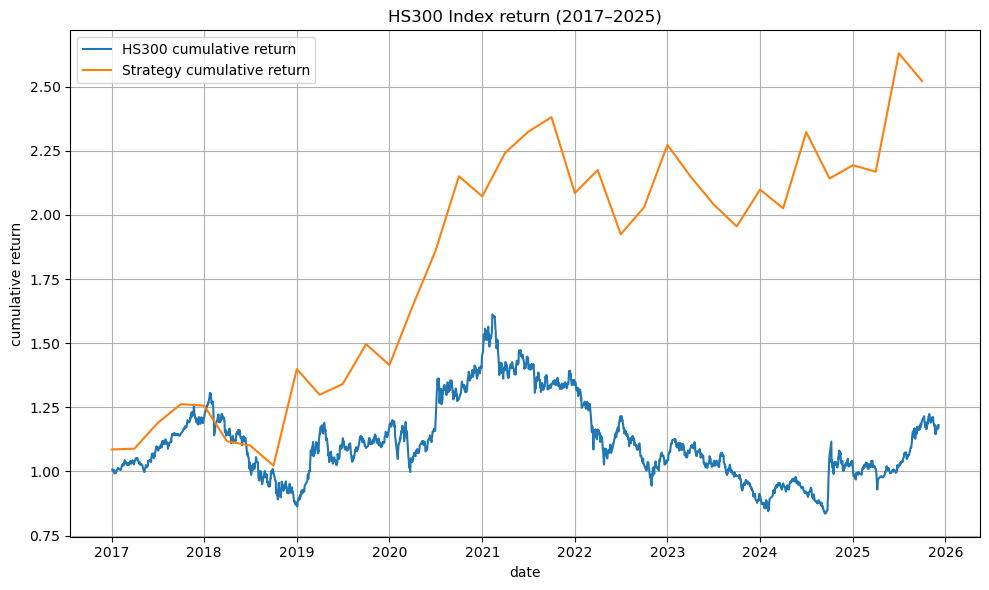

In [90]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# 复制原始数据，避免修改源数据
hs300 = HS300_index.copy()

hs300["收盘价"] = hs300["收盘价"].astype(float)
# -----------------------------
# 1. 日期处理
# -----------------------------
hs300["交易日期"] = pd.to_datetime(
    hs300["交易日期"].astype(str).str.split(".").str[0],
    format="%Y%m%d",
    errors="coerce"
)

hs300 = hs300.dropna(subset=["交易日期"])
hs300 = hs300.sort_values("交易日期")

# -----------------------------
# 2. 筛选 2017–2025
# -----------------------------
hs300 = hs300[
    (hs300["交易日期"] >= "2017-01-01") &
    (hs300["交易日期"] <= "2025-12-31")
].copy()

print(hs300.shape)
# -----------------------------
# 3. 如果没有 log_return 列，则自动生成
# -----------------------------
if "log_return" not in hs300.columns:
    hs300["log_return"] = np.log(hs300["收盘价"] / hs300["收盘价"].shift(1))

hs300 = hs300.dropna(subset=["log_return"])

# -----------------------------
# 4. 年化收益率
# -----------------------------
total_days = (hs300["交易日期"].iloc[-1] - hs300["交易日期"].iloc[0]).days
years = total_days / 365.25

cumulative_return = hs300["收盘价"].iloc[-1] / hs300["收盘价"].iloc[0]
annual_return = cumulative_return ** (1 / years) - 1

# -----------------------------
# 5. 年化波动率
# -----------------------------
daily_volatility = hs300["log_return"].std()
annual_volatility = daily_volatility * np.sqrt(252)

# -----------------------------
# 6. 夏普比率（无风险利率=0）
# -----------------------------
sharpe_ratio = annual_return / annual_volatility

# -----------------------------
# 7. 累计收益率曲线
# -----------------------------
hs300["累计收益率"] = (1 + hs300["log_return"]).cumprod()

# -----------------------------
# 8. 每年收益率
# -----------------------------
hs300["年份"] = hs300["交易日期"].dt.year
yearly_return = hs300.groupby("年份")["收盘价"].apply(lambda x: x.iloc[-1] / x.iloc[0] - 1)

# -----------------------------
# 9. 输出结果
# -----------------------------
print("===== 沪深300指数表现（2017–2025）=====")
print(f"年化收益率: {annual_return:.2%}")
print(f"年化波动率: {annual_volatility:.2%}")
print(f"夏普比率: {sharpe_ratio:.3f}")
print(f"累计收益率: {cumulative_return - 1:.2%}")
print("\n每年收益率：")
print(yearly_return)

# -----------------------------
# 10. 绘制累计收益率曲线
# -----------------------------
quarterly_returns.index = pd.PeriodIndex(quarterly_returns.index, freq="Q")
quarter_dates = quarterly_returns.index.to_timestamp()
plt.figure(figsize=(10, 6))
plt.plot(hs300["交易日期"], hs300["累计收益率"], label="HS300 cumulative return")
plt.plot(quarter_dates, (1 + quarterly_returns).cumprod(), label="Strategy cumulative return")
plt.title("HS300 Index return (2017–2025)")
plt.xlabel("date")
plt.ylabel("cumulative return")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()
